# Part 5. Car dataset clustering: Unsupervised methods

Before performing any analysis, it is essential to understand the nature of the data. We used different Exploratory Data Analysis (EDA techniques), which helps to identify the properties of data, so that the appropriate methods can be applied on the data. 

In [117]:
import pandas as pd
import numpy as np
import altair as alt
import geopandas as gpd
import statistics
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import SpectralClustering
from math import sqrt
from sklearn.metrics import silhouette_score 
from kneed import KneeLocator
from sklearn import preprocessing 
from tqdm import tqdm, trange
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score

In [5]:
#%pip install kneed

In [6]:
alt.data_transformers.disable_max_rows()

DataTransformerRegistry.enable('default')

## 1. Data loading

Loading 1.2 mln rows dataset from Part 4 (each year is represented with 100 000 samples, ENEDC feature was filled for 2021 dataset based on supervised learning results).

In [124]:
combined_df = pd.read_csv('combined_df.csv')

### Label encoding

Transforming categorical Manufacture name to a label feature.

In [125]:
#make an instance of Label Encoder
label_encoder = preprocessing.LabelEncoder()
combined_df['Mk_label'] = label_encoder.fit_transform(combined_df['Mk_clean'])
combined_df.head()

,Unnamed: 0.1,Unnamed: 0,Country,Mk,Cn,m (kg),Enedc (g/km),Ft,Fm,ec (cm3),year,Mk_clean,Mk_label
0,202974,256767,FR,RENAULT,CLIO,1255.0,179.0,Petrol,M,1598.0,2010,renault,138
1,204840,258636,FR,LEXUS,IS220,1730.0,179.0,Diesel,M,2231.0,2010,lexus,86
2,68811,77485,DE,MERCEDES-BENZ,E 350 CDI 4MATIC,1990.0,203.0,Diesel,M,2987.0,2010,mercedes,105
3,105306,117391,LU,MINI,MINI,1455.0,129.0,DIESEL,M,1598.0,2010,mini,108
4,84614,93380,DE,OPEL,Corsa,1227.0,129.0,LPG,B,1364.0,2010,opel,120


In [126]:
features = combined_df[['m (kg)', 'Enedc (g/km)', 'ec (cm3)', 'Mk_label']]

## 2. K-means clustering

The K-means clustering method is an unsupervised machine learning technique used to identify clusters of data objects in a dataset. It attempts to group similar items into the clusters, assigning each point to one specific cluster (a non-soft version was used). Each cluster is associated with one centroid or center point. Each point is assigned to the cluster with the closest centroid based on the distance in the space (in our case we used Euclidean distance). The K parameter is the number of clusters, which needs to be specified in advance. Then the algorithm assigns initial centroids, which can be chosen completely at random and assign with cluster label all points to the nearest center of the cluster in space. Then the algorithm will recalculate the centroid of each computed cluster. It repeats these steps and forms clusters, recalculating the centroids until it converges to a stable solution. The parameter which is responsible for the number of initiations needs to be specified in advance. There might be a case, when the number of initiations is not enough to converge to a stable clustering solution.

First we need to transform all numerical features to use the same scale.

In [10]:
features = combined_df[['m (kg)', 'Enedc (g/km)', 'ec (cm3)', 'Mk_label']]

In [11]:
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)

In [12]:
X_scaled.shape

(1200000, 4)

One of the most difficult tasks in this clustering algorithm is choosing the right k values. There are several methods, which help us to choose the number of clusters. 

### Choosing the Appropriate Number of Clusters
- The elbow method
- The silhouette coefficient
- The Calinski-Harabasz score (Variance ratio)
- The Davies-Bouldin score

As dataset contains 1.2 mln rows, we will use 10000-50000 samples for parameters selection analyses.

With elbow method, we run several k-means, incremented k with each iteration, and recorded the SSE: (here we use Python’s dictionary unpacking operator (**)). The quality of the cluster assignments is determined by computing the sum of the squared error (SSE) after the centroids converge, or match the previous iteration’s assignment. The SSE is defined as the sum of the squared Euclidean distances of each point to its closest centroid. Since this is a measure of error, the objective of k-means is to try to minimize this value.

Then we plot SSE as a function of the number of clusters, SSE is decreasing with increasing of k. As more centroids are added, the distance from each point to its closest centroid will decrease.
Point where the SSE curve starts to bend known as the elbow point. The x-value of this point is thought to be a reasonable trade-off between error and number of clusters.

Silhouette score: measures cluster cohesion (similarity of data point to its own cluster) and separation (to other clusters). It quantifies how well a data point fits into its assigned cluster based on two factors: 1) How close the data point is to other points in the cluster; 2) How far away the data point is from points in other clusters. Silhouette coefficient values range between -1 and 1. Larger numbers indicate that samples are closer to their clusters than they are to other clusters.

Calinski-Harabasz score (Variance ratio): is a ratio of the sum of the inter-cluster sum of squared distances and the sum of the intra-cluster sum of squared distances for all clusters. A high score means better clustering since observations in each cluster are closer together (denser), while clusters themselves are further away from each other (well separated).

Davies-Bouldin score: is the similarity between clusters. The lower Davies-Bouldin index is (lower similarity between clusters), the better the clusters are separated.

In [28]:
kmeans_kwargs = {
     "init": "random",
     "n_init": 500,
     "max_iter": 1000,
     "random_state": 17}

In [29]:
silhouette_coefficients = []
calinski_harabasz_coefficients = []
davies_bouldin_coefficients = []
sse = []


df_scaled = pd.DataFrame(X_scaled)
df_scaled_sample = df_scaled.sample(n=10000)
X_scaled_sample = df_scaled_sample.to_numpy()
    

# Notice we start at 2 clusters for cluster score coefficients
for k in trange(2, 15):
    kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
    kmeans.fit(X_scaled_sample)
    sil_score = silhouette_score(X_scaled_sample, kmeans.labels_)
    cal_score = calinski_harabasz_score(X_scaled_sample, kmeans.labels_)
    dav_score = davies_bouldin_score(X_scaled_sample, kmeans.labels_)
    silhouette_coefficients.append(sil_score)
    calinski_harabasz_coefficients.append(cal_score)
    davies_bouldin_coefficients.append(dav_score)
    sse.append(kmeans.inertia_)

100%|█████████████████████████████████████████| 13/13 [03:16<00:00, 15.13s/it]


In [30]:
kl = KneeLocator(range(2, 15), sse, curve="convex", direction="decreasing")
kl.elbow

6

Based on elbow method, the optimal number of clusters is 6

In [31]:
lst = list(range(2,15))
df_score = pd.DataFrame(
    {'Number of clusters': lst,
     'silhouette_score': silhouette_coefficients,
     'calinski_harabasz_score': calinski_harabasz_coefficients,
     'davies_bouldin_score': davies_bouldin_coefficients,
     'sse': sse
    })

In [33]:
sse_plot = alt.Chart(df_score, title = "Sum of squares at each number of clusters").mark_line(color = 'orange').encode(
    x=alt.X('Number of clusters'),
    y=alt.Y('sse', scale=alt.Scale(domain=[df_score.sse.min(), df_score.sse.max()]))
).properties(
    width=400,
    height=100)

silhouette_plot = alt.Chart(df_score, title = "Silhouette score (higher better)").mark_line(color = 'red').encode(
    x=alt.X('Number of clusters'),
    y=alt.Y('silhouette_score', scale=alt.Scale(domain=[df_score.silhouette_score.min(), df_score.silhouette_score.max()]))
).properties(
    width=400,
    height=100)

calinski_plot = alt.Chart(df_score, title = "Calinski-Harabasz score (higher better)").mark_line(color ='green').encode(
    x=alt.X('Number of clusters'),
    y=alt.Y('calinski_harabasz_score', scale=alt.Scale(domain=[df_score.calinski_harabasz_score.min(), df_score.calinski_harabasz_score.max()]))
).properties(
    width=400,
    height=100
)

davies_plot = alt.Chart(df_score, title = 'Davies-Bouldin score (lower better)').mark_line(color ='blue').encode(
    x=alt.X('Number of clusters'),
    y=alt.Y('davies_bouldin_score', scale=alt.Scale(domain=[df_score.davies_bouldin_score.min(), df_score.davies_bouldin_score.max()]))
).properties(
    width=400,
    height=100
)

result = alt.vconcat(sse_plot, silhouette_plot,calinski_plot,davies_plot)

result.configure_title(fontSize=18)

alt.VConcatChart(...)

Based on Silhouette Coefficient, the optimal number of clusters is 8. Let's clusterize data with 8 clusters.

In [34]:
kmeans = KMeans(init = 'random',
                n_clusters = 8,
                n_init = 500,
                max_iter = 1000,
                random_state = 42)

In [35]:
kmeans.fit(X_scaled)
# The lowest SSE value
kmeans.inertia_

1162177.7620567675

In [36]:
# Final locations of the centroid
kmeans.cluster_centers_

array([[ 1.36930675, -2.53866187,  0.15412154, -0.07466175],
       [-0.77261576, -0.60972191, -0.64608661,  0.76839198],
       [ 1.30054063,  1.13100069,  2.02267565, -1.12014258],
       [ 0.37083171,  0.17713102,  0.2129981 , -1.20813028],
       [ 0.27857579,  0.18837415,  0.17368875,  0.7233656 ],
       [ 1.81447924,  3.87318048,  4.77653486, -0.44665103],
       [-0.81520615, -0.49128206, -0.69874913, -1.03853885],
       [ 1.99324968,  1.7065759 ,  0.9485299 ,  0.34004958]])

In [37]:
# The number of iterations required to converge (much less than 500 :-))
kmeans.n_iter_

12

In [972]:
# The labels
kmeans.labels_

array([2, 1, 3, ..., 0, 1, 4], dtype=int32)

In [38]:
def scatter_plot_clusters_sample(X_scaled, labels):
    dfm = pd.DataFrame(X_scaled)
    dfm = dfm.sample(n=50000)
    column_names = []
    for i in range(len(dfm.columns)):
        column = 'Feature'+ str(dfm.columns[i]+1)
        column_names.append(column)
    dfm.columns = column_names
    dfm['Label'] = labels[dfm.index]
    scatter_plot_base = alt.Chart(dfm).mark_circle(size=50).encode(color='Label:N')
    f1_f2 = scatter_plot_base.encode(x='Feature1:Q',y='Feature2:Q')
    f1_f3 = scatter_plot_base.encode(x='Feature1:Q',y='Feature3:Q')
    f2_f3 = scatter_plot_base.encode(x='Feature2:Q',y='Feature3:Q')
    f2_f4 = scatter_plot_base.encode(x='Feature2:Q',y='Feature4:Q')
    
    plots1_2 = alt.hconcat(f1_f2,f1_f3)
    plots3_4 = alt.hconcat(f2_f3, f2_f4)
    plots1_2_3_4 = alt.vconcat(plots1_2,plots3_4)
    
    return plots1_2_3_4

In [39]:
scatter_plot_clusters_sample(X_scaled, kmeans.labels_)

alt.VConcatChart(...)

From the plots above we see cloud of blue circles (label 0) is well separated from other label clouds.

In [40]:
# Adding column to our dataframe with cluster labels
combined_df['label_kmeans'] = kmeans.labels_

In [41]:
# Counting each label per country and per year
final_clusters = combined_df.groupby(['Country', 'year']).label_kmeans.value_counts().to_frame()
final_clusters = final_clusters.unstack().reset_index()
final_clusters = final_clusters.droplevel(0, axis=1)
final_clusters.columns = ['Country', 'year', 'Cluster0', 'Cluster1', 
                          'Cluster2', 'Cluster3', 'Cluster4', 'Cluster5', 'Cluster6', 'Cluster7']

In [42]:
final_clusters.head()

,Country,year,Cluster0,Cluster1,Cluster2,Cluster3,Cluster4,Cluster5,Cluster6,Cluster7
0,AT,2010,NaN,917.0,381.0,753.0,2034.0,176.0,423.0,1012.0
1,AT,2011,1.0,796.0,274.0,527.0,1850.0,122.0,325.0,816.0
2,AT,2012,3.0,969.0,275.0,753.0,1941.0,123.0,488.0,795.0
3,AT,2013,8.0,1044.0,221.0,605.0,1340.0,80.0,555.0,577.0
4,AT,2014,13.0,2373.0,279.0,842.0,2348.0,105.0,595.0,678.0


For some years and countries some labels are missing - NaN values, which we will fill with zero later.

In [43]:
# Finding the total number of all car albels per country and year and assigning it to column 'Total'
final_clusters.iloc[:,2:13]
final_clusters['Total'] = final_clusters.iloc[:,2:13].sum(axis=1)

In [48]:
# Checking that all country name are in the same format
final_clusters['Country'] = final_clusters['Country'].str.upper()
# Filling NaN values with zero
final_clusters = final_clusters.fillna(0)
# Caluclating the percentage of low CO2 emission cars (Cluster 0) by dividing to Total and multiplying by 100.
final_clusters['perc_share_low_CO2_kmeans_30'] = final_clusters['Cluster0']/final_clusters['Total']*100

In [49]:
final_clusters.head(5)

,Country,year,Cluster0,Cluster1,Cluster2,Cluster3,Cluster4,Cluster5,Cluster6,Cluster7,Total,perc_share_low_CO2_kmeans_30
0,AT,2010,0.0,917.0,381.0,753.0,2034.0,176.0,423.0,1012.0,5696.0,0.000000
1,AT,2011,1.0,796.0,274.0,527.0,1850.0,122.0,325.0,816.0,4711.0,0.021227
2,AT,2012,3.0,969.0,275.0,753.0,1941.0,123.0,488.0,795.0,5347.0,0.056106
3,AT,2013,8.0,1044.0,221.0,605.0,1340.0,80.0,555.0,577.0,4430.0,0.180587
4,AT,2014,13.0,2373.0,279.0,842.0,2348.0,105.0,595.0,678.0,7233.0,0.179732


We ran K-means clustering for 30 different (1 200 000) samples and calculated the percentage of low CO2 emission cars per country per year and saved this df as K_means_share_CO2_car_percentage_21feb30.csv, which we used later for forecasting exercise.

In [50]:
to_merge = final_clusters[['Country','year','perc_share_low_CO2_kmeans_30']]

In [51]:
to_merge.head()

,Country,year,perc_share_low_CO2_kmeans_30
0,AT,2010,0.000000
1,AT,2011,0.021227
2,AT,2012,0.056106
3,AT,2013,0.180587
4,AT,2014,0.179732


In [986]:
#to_merge.to_csv('K_means_share_CO2_car_percentage_21feb30.csv')

In [ ]:
#to_merge.loc[to_merge['perc_share_low_CO2'].idxmax()]

In [52]:
# Loading europe.topojson file
country_topo = gpd.read_file('europe.topojson')

In [53]:
final_topo = pd.merge(country_topo, to_merge, left_on='id', right_on='Country', how='right')

In [54]:
final_topo

,id,NAME,geometry,Country,year,perc_share_low_CO2_kmeans_30
0,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2010,0.000000
1,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2011,0.021227
2,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2012,0.056106
3,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2013,0.180587
4,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2014,0.179732
...,...,...,...,...,...,...
332,PT,Portugal,"POLYGON ((-7.42942 37.25440, -7.41444 37.18772...",PT,2021,11.820013
333,RO,Romania,"POLYGON ((22.89261 47.95164, 22.93007 47.95581...",RO,2021,1.600610
334,SE,Sweden,"MULTIPOLYGON (((16.83869 56.82782, 16.81621 56...",SE,2021,34.449560
335,SI,Slovenia,"POLYGON ((13.72182 46.52646, 13.77427 46.51812...",SI,2021,100.000000


In [60]:
K_means_CO2share_chart = alt.Chart(final_topo, title = 'Share of low CO2 emission cars in Europe').mark_geoshape(
    stroke='grey'
).encode(
    color = alt.Color('perc_share_low_CO2_kmeans_30:Q', title="Percentage", scale=alt.Scale(domain=[0,40],
                                      scheme='goldgreen', reverse=False)),  
    tooltip = ['NAME', alt.Tooltip('perc_share_low_CO2_kmeans_30:Q', title='Low CO2 cars (%)', format='.1f')],
    facet=alt.Facet(
    'year:N', columns=4, header=alt.Header(labelFontSize=40))
).properties(
    width=400,
    height=400
).project(
    type= 'equalEarth',
    scale= 600,                          # Magnify
    center= [-20,80],                     # [lon, lat]
    clipExtent= [[0, 0], [800, 800]],    # [[left, top], [right, bottom]]
).properties(
    title='Share (%) of low emission vehicles in the EU').configure_title(fontSize=44).configure_legend(
    gradientLength=1300,
    gradientThickness=70,
    titleFontSize=28,
    labelFontSize=25
)  

In [61]:
K_means_CO2share_chart 

alt.Chart(...)

Extracting vehicles with low CO2 emission based on clustering label results

In [62]:
low_CO2_dataset = combined_df[combined_df['label_kmeans']==0]

In [64]:
#Counting which manufactur cars are the most popular in the low C02 vehicles clustering result 
manufacture_kmeans = low_CO2_dataset.groupby('Mk_clean').size().to_frame()
manufacture_kmeans = manufacture_kmeans.reset_index()
manufacture_kmeans.columns = ['Mk_clean', 'Number']

In [65]:
manufacture_kmeans = manufacture_kmeans.sort_values('Number')

Building a histogram chart with top 5 most popular low emission car brands

In [66]:
hist_kmeans = alt.Chart(manufacture_kmeans, title = 'Top 5 most popular low emission car brands').transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'red').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), title='Percent from low CO2 emission cars'),
    y=alt.Y('Mk_clean:N',sort='-x', title='Car brand')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [67]:
hist_kmeans

alt.Chart(...)

As a next step, we filter our dataset with the top 3 popular car brands and then check the most popular models for each brand

In [68]:
top1_kmeans = low_CO2_dataset[low_CO2_dataset['Mk_clean']=='{}'.format(manufacture_kmeans['Mk_clean'].iloc[-1])]
top1_kmeans['Cn'] = top1_kmeans['Cn'].str.lower()
top1_model_kmeans = top1_kmeans.groupby('Cn').size().to_frame()
top1_model_kmeans = top1_model_kmeans.reset_index()
top1_model_kmeans.columns = ['Cn', 'Number']

/var/folders/wk/12tjkfvs55n97yf4c0bnn16h0000gn/T/ipykernel_22798/1896883969.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top1_kmeans['Cn'] = top1_kmeans['Cn'].str.lower()


In [69]:
top1_model_kmeans_chart = alt.Chart(top1_model_kmeans, 
                              title = 'Top 5 most popular low emission {} car models'.format(manufacture_kmeans['Mk_clean'].iloc[-1])
).transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'green').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), 
              title='Percent from low CO2 emission {} cars'.format(manufacture_kmeans['Mk_clean'].iloc[-1])),
    y=alt.Y('Cn:N',sort='-x', title='Car model')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [70]:
top1_model_kmeans_chart

alt.Chart(...)

In [71]:
top2_kmeans = low_CO2_dataset[low_CO2_dataset['Mk_clean']=='{}'.format(manufacture_kmeans['Mk_clean'].iloc[-2])]
top2_kmeans['Cn'] = top2_kmeans['Cn'].str.lower()
top2_model_kmeans = top2_kmeans.groupby('Cn').size().to_frame()
top2_model_kmeans = top2_model_kmeans.reset_index()
top2_model_kmeans.columns = ['Cn', 'Number']

/var/folders/wk/12tjkfvs55n97yf4c0bnn16h0000gn/T/ipykernel_22798/847589.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top2_kmeans['Cn'] = top2_kmeans['Cn'].str.lower()


In [72]:
top2_model_kmeans_chart = alt.Chart(top2_model_kmeans, 
                              title = 'Top 5 most popular low emission {} car models'.format(manufacture_kmeans['Mk_clean'].iloc[-2])
).transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'blue').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), 
              title='Percent from low CO2 emission {} cars'.format(manufacture_kmeans['Mk_clean'].iloc[-2])),
    y=alt.Y('Cn:N',sort='-x', title='Car model')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [73]:
top2_model_kmeans_chart

alt.Chart(...)

In [74]:
top3_kmeans = low_CO2_dataset[low_CO2_dataset['Mk_clean']=='{}'.format(manufacture_kmeans['Mk_clean'].iloc[-3])]
top3_kmeans['Cn'] = top3_kmeans['Cn'].str.lower()
top3_model_kmeans = top3_kmeans.groupby('Cn').size().to_frame()
top3_model_kmeans = top3_model_kmeans.reset_index()
top3_model_kmeans.columns = ['Cn', 'Number']

/var/folders/wk/12tjkfvs55n97yf4c0bnn16h0000gn/T/ipykernel_22798/3504514298.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top3_kmeans['Cn'] = top3_kmeans['Cn'].str.lower()


In [75]:
top3_model_kmeans_chart = alt.Chart(top3_model_kmeans, 
                              title = 'Top 5 most popular low emission {} car models'.format(manufacture_kmeans['Mk_clean'].iloc[-3])
).transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'orange').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), 
              title='Percent from low CO2 emission {} cars'.format(manufacture_kmeans['Mk_clean'].iloc[-3])),
    y=alt.Y('Cn:N',sort='-x', title='Car model')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [76]:
top3_model_kmeans_chart

alt.Chart(...)

## 3. DB-Scan

The basic idea behind DBSCAN is that clusters are regions in data space that are more densely populated with data points, and separated by regions that are empty, or at least much less densely populated. There are three main steps to the DBSCAN algorithm. Step1: All points that lie in a more dense region are called core samples and controlled by two main parameters: minimum samples and epsilon. For a data point, if the number of other data points that lie within a distance of epsilon from it, more than minimum samples, then that data point is labeled as a core sample. All samples that are considered closely connected neighbors for the core points are put into the same cluster. Step2: Points that are within a distance of epsilon from the core points, but don't have enough close neighbors (less than minimum samples) to be considered core points themselves, are called boundary points (another cluster). Step3: Any non-core points that are not close enough to any cluster are labeled as outliers. Two parameters need to be specified in advance to DB-scan clustering: epsilon and minimum samples, no requirement to specify the number of clusters. We tried to implement DB-scan on our data (computationally expensive - no errors only on data with less than 200 000 data records on a local machine), however with no good results as K-means and spectral clustering. We applied 2 available techniques to choose epsilon and minimum samples (on 200 000 sample, as changing the sample of your data impacts the density of it):
- Method 1: Calculating the distance to nearest (we tried the range 1-20) neighbor for all points, then to find the median of it and multiplied to (we tried the range 1.5 - 3.5) and use this value as epsilon. And the number of minimum samples is the number K to the nearest neighbor, from epsilon calculation. 
- Method 2: Calculating the distance to nearest (we tried the range 1-20) neighbor for all points, then plot the sorted distances and choose as epsilon the value close to elbow.
Both methods could not combine two clouds of low-CO2 emission vehicles into one cluster, as the distance between both of them is larger compared to the distance to the other cars.

In [8]:
len(combined_df)

1200000

if you set the value of eps to something that's much too small, that all the points in your data set will be labeled as a -1, they'll be labeled as noise or outlier points. Because with a very small value of eps nothing will be within that neighborhood. Conversely, if you set eps to be too large, all points would be considered neighbors for all of the other points, and so they'll all be put into the same large single cluster.

As the density of data is changing with sampling, we applied our tests to choose eps and min_num on 200 000 samples and then tried to apply them on the same dataset to get clusters.

In [77]:
combined_df_sample200000 = combined_df.sample(n=200000)

In [78]:
sample = combined_df_sample200000[['m (kg)', 'Enedc (g/km)', 'ec (cm3)', 'Mk_label']]

In [80]:
scaler = StandardScaler()
X_scaled1000 = scaler.fit_transform(sample)

In [81]:
X_scaled1000.shape

(200000, 4)

Method 1: For each of points, we compute the k-nearest-neighbor distance to k equals (we tested range 1-20), find the nearest neighbor. How far is nearest neighbor for each point for k neigbor. We get a distribution of distance values. We took the median (also tried with mean) of this distance distribution and then set eps as 3 (we tried the range 1.5-3.5) the medians from the distance distribution. Then, with this epsilon, we set min samples to k. We tried to adjust both of them.

In [82]:
import scipy.spatial
kdt = scipy.spatial.cKDTree(X_scaled1000) 
k = 1 # number of nearest neighbors 
dists, neighs = kdt.query(X_scaled1000, k+1)
avg_dists = np.mean(dists[:, 1:], axis=1)

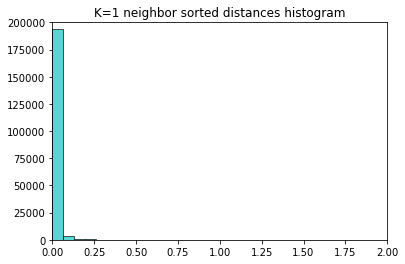

In [90]:
dist_plot_k = plt.hist(np.sort(avg_dists), bins=120, color='c', edgecolor='k', alpha=0.65)
plt.title('K=1 neighbor sorted distances histogram', fontsize=12)
plt.axis([0, 2, 0, 200000])
plt.show()

In [107]:
3*np.mean(np.sort(avg_dists))

0.12407464415004536

Method 2: Calculating the distance to nearest (we tried the range 1-20) neighbor for all points, then plot the sorted distances and choose as epsilon the value close to elbow

(0.05, 0.05)

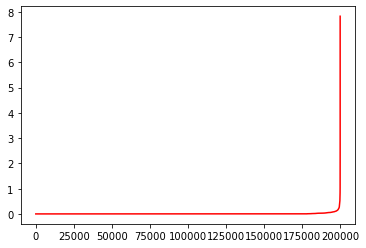

In [92]:
x = range(len(avg_dists))
plt.plot(x,np.sort(avg_dists), color = 'red')
#plt.axis([195500, 200000, 0, 0.5])
plt.margins()

In [717]:
kl = KneeLocator(range(len(avg_dists)), np.sort(avg_dists),  curve="convex", direction="increasing")
kl.elbow

199972

In [718]:
b = np.sort(avg_dists)
b[199912]

1.2100471075288308

In [101]:
number_samples = list(range(65,76))

In [102]:
silhouette_coefficients_db_scan = []
calinski_harabasz_coefficients_db_scan = []
davies_bouldin_coefficients_db_scan = []

# we start with ranging n_samples and epsilon parameters for cluster score coefficients
for sample in tqdm(number_samples):
    dbscan = DBSCAN(eps=0.724, min_samples = sample, n_jobs=-1)
    dbscan.fit_predict(X_scaled1000)
    sil_score_dbscan = silhouette_score(X_scaled1000, dbscan.labels_)
    cal_score_dbscan = calinski_harabasz_score(X_scaled1000, dbscan.labels_)
    dav_score_dbscan = davies_bouldin_score(X_scaled1000, dbscan.labels_)
    silhouette_coefficients_db_scan.append(sil_score_dbscan)
    calinski_harabasz_coefficients_db_scan.append(cal_score_dbscan)
    davies_bouldin_coefficients_db_scan.append(dav_score_dbscan)

100%|██████████████████████████████████████| 11/11 [1:28:29<00:00, 482.72s/it]


In [103]:
df_db_eps_score = pd.DataFrame(
    {#'Epsilon':radius,
     'Number of samples':number_samples,
     'silhouette_score': silhouette_coefficients_db_scan,
     'calinski_harabasz_score': calinski_harabasz_coefficients_db_scan,
     'davies_bouldin_score': davies_bouldin_coefficients_db_scan,
    })

In [104]:
df_db_eps_score.head(11)

,Number of samples,silhouette_score,calinski_harabasz_score,davies_bouldin_score
0,65,0.319159,3746.174338,1.706625
1,66,0.318145,3418.952652,1.737855
2,67,0.316966,3139.317609,1.757816
3,68,0.317014,3143.249056,1.754512
4,69,0.317204,3426.672064,1.677827
5,70,0.317217,3428.203903,1.680523
6,71,0.317221,3428.651659,1.679993
7,72,0.316540,3660.999914,1.965579
8,73,0.316664,3680.089835,1.956603
9,74,0.320026,3993.400028,2.204265


In [105]:
df_db_eps_score.iloc[9]

Number of samples            74.000000
silhouette_score              0.320026
calinski_harabasz_score    3993.400028
davies_bouldin_score          2.204265
Name: 9, dtype: float64

In [106]:
df_db_eps_score.nlargest(n=25, columns=['silhouette_score', 'calinski_harabasz_score'])

,Number of samples,silhouette_score,calinski_harabasz_score,davies_bouldin_score
9,74,0.320026,3993.400028,2.204265
10,75,0.319980,3605.960784,2.103014
0,65,0.319159,3746.174338,1.706625
1,66,0.318145,3418.952652,1.737855
6,71,0.317221,3428.651659,1.679993
5,70,0.317217,3428.203903,1.680523
4,69,0.317204,3426.672064,1.677827
3,68,0.317014,3143.249056,1.754512
2,67,0.316966,3139.317609,1.757816
8,73,0.316664,3680.089835,1.956603


In [107]:
silhouette_plot_db_scan = alt.Chart(df_db_eps_score, title = "Silhouette score (higher better)").mark_line().encode(
    x=alt.X('Number of samples'),
    y=alt.Y('silhouette_score', scale=alt.Scale(domain=[df_db_eps_score.silhouette_score.min(), df_db_eps_score.silhouette_score.max()])),
    #color = 'Epsilon:N',
    tooltip=[alt.Tooltip('Number of samples:N', title='Number of samples')]
).properties(
    width=800,
    height=200)

calinski_plot_db_scan = alt.Chart(df_db_eps_score, title = "Calinski-Harabasz score (higher better)").mark_line().encode(
    x=alt.X('Number of samples'),
    y=alt.Y('calinski_harabasz_score', scale=alt.Scale(domain=[df_db_eps_score.calinski_harabasz_score.min(), df_db_eps_score.calinski_harabasz_score.max()])),
    #color = 'Epsilon:N',
    tooltip=[alt.Tooltip('Number of samples:N', title='Number of samples')]
).properties(
    width=800,
    height=200
)

davies_plot_db_scan = alt.Chart(df_db_eps_score, title = 'Davies-Bouldin score (lower better)').mark_line().encode(
    x=alt.X('Number of samples'),
    y=alt.Y('davies_bouldin_score', scale=alt.Scale(domain=[df_db_eps_score.davies_bouldin_score.min(), df_db_eps_score.davies_bouldin_score.max()])),
    #color = 'Epsilon:N',
    tooltip=[alt.Tooltip('Number of samples:N', title='Number of samples')]
).properties(
    width=800,
    height=200
)

result_db_scan = alt.vconcat(silhouette_plot_db_scan,calinski_plot_db_scan,davies_plot_db_scan)

result_db_scan.configure_title(fontSize=18)

alt.VConcatChart(...)

In [108]:
dbscan = DBSCAN(eps=0.724, min_samples = 65, n_jobs=-1)

In [109]:
combined_df_sample500000 = combined_df.sample(n=200000)
sample500000 = combined_df_sample500000[['m (kg)', 'Enedc (g/km)', 'ec (cm3)', 'Mk_label']]
X_scaled500000 = scaler.fit_transform(sample500000)

In [110]:
cls = dbscan.fit_predict(X_scaled500000)
print('Cluster membership values:\n{}', format(cls))

Cluster membership values:
{} [0 0 0 ... 0 0 0]


In [111]:
def scatter_plot_clusters(X_scaled, labels):
    dfm = pd.DataFrame(X_scaled)
    dfm = dfm.sample(n=50000)
    column_names = []
    for i in range(len(dfm.columns)):
        column = 'Feature'+ str(dfm.columns[i]+1)
        column_names.append(column)
    dfm.columns = column_names
    dfm['Label'] = labels[dfm.index]
    scatter_plot_base = alt.Chart(dfm).mark_circle(size=50).encode(color = alt.Color('Label:N'))
    f1_f2 = scatter_plot_base.encode(x='Feature1:Q',y='Feature2:Q')
    f1_f3 = scatter_plot_base.encode(x='Feature1:Q',y='Feature3:Q')
    f2_f3 = scatter_plot_base.encode(x='Feature2:Q',y='Feature3:Q')
    f2_f4 = scatter_plot_base.encode(x='Feature2:Q',y='Feature4:Q')
    
    plots1_2 = alt.hconcat(f1_f2,f1_f3)
    plots3_4 = alt.hconcat(f2_f3)
    plots1_2_3_4 = alt.vconcat(plots1_2,plots3_4)
    
    return plots1_2_3_4

In [112]:
scatter_plot_clusters(X_scaled500000, cls)

alt.VConcatChart(...)

## 3. Spectral clustering

The Spectral clustering can be reformulated using the similarity graph: we want to find a partition of the graph such that the edges between different groups have very low weights (which means that points in different clusters are dissimilar from each other) and the edges within a group have high weights (which means that points within the same cluster are similar to each other). The general approach is to construct an affinity matrix. An affinity matrix is like an adjacency matrix, except the value for a pair of points expresses how similar those points are to each other. If pairs of points are very dissimilar then the affinity is 0. If the points are identical, then the affinity might be 1. Then the Graph Laplacian is created by subtracting the affinity matrix from the degree matrix (degree value on diagonal). This matrix has the degree for each point on diagonal and negative similarity with other points, it has special properties (eigenvalues and eigenvectors), which helps to understand the number of clusters (from eigenvalues) and cluster labels (using eigenvectors) (Spectral Clustering. Towards Data Science.).  
Input parameters: Number of clusters (default is 8), Number of the k-means algorithm initiations with different centroid seeds (default is 10). Affinity: how to construct the affinity matrix, default is using a radial basis function kernel.  We applied spectral clustering on three features: ‘mass’, ‘Enedc’ and ‘engine capacity’. We used default parameters, except the number of clusters = 7.

In [127]:
df_spectral = combined_df.sample(n=50000)
features_spectral = df_spectral[['m (kg)', 'Enedc (g/km)', 'ec (cm3)']]

In [128]:
X_spectral = scaler.fit_transform(features_spectral)

In [129]:
len(X_spectral)

50000

In [130]:
clustering = SpectralClustering(n_clusters=7,
         assign_labels='discretize',
         random_state=0).fit(X_spectral)

In [131]:
def scatter_plot_clusters_sample(X_scaled, labels):
    dfm = pd.DataFrame(X_scaled)
    column_names = []
    for i in range(len(dfm.columns)):
        column = 'Feature'+ str(dfm.columns[i]+1)
        column_names.append(column)
    dfm.columns = column_names
    dfm['Label'] = labels
    scatter_plot_base = alt.Chart(dfm).mark_circle(size=50).encode(color='Label:N')
    f1_f2 = scatter_plot_base.encode(x='Feature1:Q',y='Feature2:Q')
    f1_f3 = scatter_plot_base.encode(x='Feature1:Q',y='Feature3:Q')
    f2_f3 = scatter_plot_base.encode(x='Feature2:Q',y='Feature3:Q')
    f2_f4 = scatter_plot_base.encode(x='Feature2:Q',y='Feature4:Q')
    
    plots1_2 = alt.hconcat(f1_f2,f1_f3)
    plots3_4 = alt.hconcat(f2_f3, f2_f4)
    plots1_2_3_4 = alt.vconcat(plots1_2,plots3_4)
    
    return plots1_2_3_4

In [156]:
scatter_plot_clusters_sample(X_spectral, clustering.labels_)

alt.VConcatChart(...)

From the plots above we see cloud of red circles (label 2) is well separated from other label clouds.
We repeat the same steps as for K-means clustering to visualize our results on a map view.

In [151]:
df_spectral['label_spectral'] = clustering.labels_

In [157]:
final_clusters_spectral = df_spectral.groupby(['Country', 'year']).label_spectral.value_counts().to_frame()
final_clusters_spectral = final_clusters_spectral.unstack().reset_index()
final_clusters_spectral = final_clusters_spectral.droplevel(0, axis=1)
final_clusters_spectral.columns = ['Country', 'year', 'Cluster0', 'Cluster1', 
                          'Cluster2', 'Cluster3', 'Cluster4', 'Cluster5', 'Cluster6']

In [158]:
final_clusters_spectral.iloc[:,2:13]
final_clusters_spectral['Total'] = final_clusters_spectral.iloc[:,2:13].sum(axis=1)

In [159]:
final_clusters_spectral['Country'] = final_clusters_spectral['Country'].str.upper()
final_clusters_spectral = final_clusters_spectral.fillna(0)
final_clusters_spectral['perc_share_low_CO2_sp'] = final_clusters_spectral['Cluster2']/final_clusters_spectral['Total']*100

In [160]:
to_merge_spectral = final_clusters_spectral[['Country','year','perc_share_low_CO2_sp']]

In [161]:
final_topo_spectral = pd.merge(country_topo, to_merge_spectral, left_on='id', right_on='Country', how='right')

In [162]:
final_topo_spectral.head()

,id,NAME,geometry,Country,year,perc_share_low_CO2_sp
0,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2010,0.0
1,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2011,0.0
2,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2012,0.0
3,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2013,0.0
4,AT,Austria,"POLYGON ((13.82672 48.77259, 13.85669 48.77259...",AT,2014,0.0


In [163]:
Spectral_CO2share_chart = alt.Chart(final_topo_spectral, title = 'Share of low CO2 emission cars in Europe').mark_geoshape(
    stroke='grey'
).encode(
    color = alt.Color('perc_share_low_CO2_sp:Q', title="Percentage", scale=alt.Scale(domain=[0,40],
                                      scheme='yellowgreen', reverse=False)),  
    tooltip = ['NAME', alt.Tooltip('perc_share_low_CO2_sp:Q', title='Low CO2 cars (%)', format='.1f')],
    facet=alt.Facet(
    'year:N', columns=4, header=alt.Header(labelFontSize=40))
).properties(
    width=400,
    height=400
).project(
    type= 'equalEarth',
    scale= 600,                          # Magnify
    center= [-20,80],                     # [lon, lat]
    clipExtent= [[0, 0], [800, 800]],    # [[left, top], [right, bottom]]
).properties(
    title='Share (%) of low emission vehicles in the EU').configure_title(fontSize=44).configure_legend(
    gradientLength=1300,
    gradientThickness=70,
    titleFontSize=28,
    labelFontSize=25
)  

In [164]:
Spectral_CO2share_chart

alt.Chart(...)

Extracting vehicles with low CO2 emission based on clustering label results

In [165]:
low_CO2_dataset_spectral = df_spectral[df_spectral['label_spectral']==2]

In [166]:
#Counting which manufactur cars are the most popular in the low C02 vehicles clustering result 
manufacture_spectral = low_CO2_dataset_spectral.groupby('Mk_clean').size().to_frame()
manufacture_spectral = manufacture_spectral.reset_index()
manufacture_spectral.columns = ['Mk_clean', 'Number']

In [167]:
manufacture_spectral = manufacture_spectral.sort_values('Number')

Building a histogram chart with top 5 most popular low emission car brands

In [168]:
hist_spectral = alt.Chart(manufacture_spectral, title = 'Top 5 most popular low emission car brands').transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'red').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), title='Percent from low CO2 emission cars'),
    y=alt.Y('Mk_clean:N',sort='-x', title='Car brand')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [169]:
hist_spectral

alt.Chart(...)

As a next step, we filter our dataset with the top 3 popular car brands and then check the most popular models for each brand

In [170]:
top1_spectral = low_CO2_dataset_spectral[low_CO2_dataset_spectral['Mk_clean']=='{}'.format(manufacture_spectral['Mk_clean'].iloc[-1])]
top1_spectral['Cn'] = top1_spectral['Cn'].str.lower()
top1_model_spectral = top1_spectral.groupby('Cn').size().to_frame()
top1_model_spectral = top1_model_spectral.reset_index()
top1_model_spectral.columns = ['Cn', 'Number']

/var/folders/wk/12tjkfvs55n97yf4c0bnn16h0000gn/T/ipykernel_22798/177493675.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top1_spectral['Cn'] = top1_spectral['Cn'].str.lower()


In [171]:
top1_model_spectral_chart = alt.Chart(top1_model_spectral, 
                              title = 'Top 5 most popular low emission {} car models'.format(manufacture_spectral['Mk_clean'].iloc[-1])
).transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'green').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), 
              title='Percent from low CO2 emission {} cars'.format(manufacture_spectral['Mk_clean'].iloc[-1])),
    y=alt.Y('Cn:N',sort='-x', title='Car model')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [172]:
top1_model_spectral_chart

alt.Chart(...)

In [173]:
top2_spectral = low_CO2_dataset_spectral[low_CO2_dataset_spectral['Mk_clean']=='{}'.format(manufacture_spectral['Mk_clean'].iloc[-2])]
top2_spectral['Cn'] = top2_spectral['Cn'].str.lower()
top2_model_spectral = top2_spectral.groupby('Cn').size().to_frame()
top2_model_spectral = top2_model_spectral.reset_index()
top2_model_spectral.columns = ['Cn', 'Number']

/var/folders/wk/12tjkfvs55n97yf4c0bnn16h0000gn/T/ipykernel_22798/1814821130.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top2_spectral['Cn'] = top2_spectral['Cn'].str.lower()


In [174]:
top2_model_spectral_chart = alt.Chart(top2_model_spectral, 
                              title = 'Top 5 most popular low emission {} car models'.format(manufacture_spectral['Mk_clean'].iloc[-2])
).transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'blue').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), 
              title='Percent from low CO2 emission {} cars'.format(manufacture_spectral['Mk_clean'].iloc[-2])),
    y=alt.Y('Cn:N',sort='-x', title='Car model')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [175]:
top2_model_spectral_chart

alt.Chart(...)

In [176]:
top3_spectral = low_CO2_dataset_spectral[low_CO2_dataset_spectral['Mk_clean']=='{}'.format(manufacture_spectral['Mk_clean'].iloc[-3])]
top3_spectral['Cn'] = top3_spectral['Cn'].str.lower()
top3_model_spectral = top3_spectral.groupby('Cn').size().to_frame()
top3_model_spectral = top3_model_spectral.reset_index()
top3_model_spectral.columns = ['Cn', 'Number']

/var/folders/wk/12tjkfvs55n97yf4c0bnn16h0000gn/T/ipykernel_22798/2763417526.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top3_spectral['Cn'] = top3_spectral['Cn'].str.lower()


In [177]:
top3_model_spectral_chart = alt.Chart(top3_model_spectral, 
                              title = 'Top 5 most popular low emission {} car models'.format(manufacture_spectral['Mk_clean'].iloc[-3])
).transform_joinaggregate(
    TotalCount='sum(Number)',
).transform_calculate(
    PercentOfTotal="datum.Number / datum.TotalCount"
).transform_window(
    rank='rank(PercentOfTotal)',
    sort=[alt.SortField('PercentOfTotal', order='descending')]
).transform_filter(
    (alt.datum.rank < 6)
).mark_bar(color = 'orange').encode(
    x = alt.X('PercentOfTotal:Q', axis=alt.Axis(format='.0%'), 
              title='Percent from low CO2 emission {} cars'.format(manufacture_spectral['Mk_clean'].iloc[-3])),
    y=alt.Y('Cn:N',sort='-x', title='Car model')).configure_axis(
    labelFontSize=12,
    titleFontSize=14
).configure_title(fontSize=16)

In [178]:
top3_model_spectral_chart

alt.Chart(...)

Results from K-means and Spectral clustering looks almost the same. For Spectral clustering we tested the outcome on 12 different samples. First 10 were very stable and showing clear separation. The last 2 results showed some noise. This might be related to the sample size (50 000), that does not capture the variance of full one.

# References:
- Sefidian, A. M. How to determine epsilon and MinPts parameters of DBSCAN clustering. Sefidian Academy. http://www.sefidian.com/2020/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/
- (2019, February 21). Spectral Clustering. Towards Data Science. https://towardsdatascience.com/spectral-clustering-aba2640c0d5b